In [ ]:
 import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
tf.__version__

'2.11.0'

In [ ]:
base_model = tf.keras.applications.InceptionV3(include_top = False, weights = 'imagenet')

87910968/87910968 [==============================] - 3s 0us/step


In [ ]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

In [ ]:
len(base_model.layers)

311

In [ ]:
#relu
# names = ['mixed3','mixed5','mixed8','mixed9']
names = ['mixed3','mixed5']

In [ ]:
base_model.input

<KerasTensor: shape=(None, None, None, 3) dtype=float32 (created by layer 'input_1')>

In [ ]:
layers= [base_model.get_layer(name).output for name in names]
layers


[<KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed3')>,
 <KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed5')>]

In [ ]:
#this neural network as 2 output layers
deep_dream_model= tf.keras.Model(inputs = base_model.input,outputs = layers)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
image= tf.keras.preprocessing.image.load_img('/content/drive/MyDrive/Computer Vision Masterclass/Images/StaryNight.jpg',target_size = (225,375))

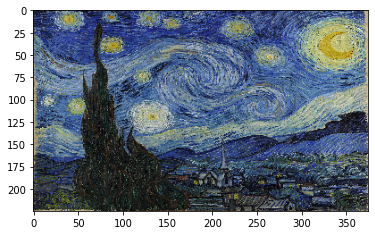

In [ ]:
plt.imshow(image);

In [ ]:
type(image)

PIL.Image.Image

In [ ]:
image.size

(375, 225)

In [ ]:
image.mode

'RGB'

In [ ]:
len(image.mode)

3

In [ ]:
list(image.getdata()) #to get all the pixels

[(6, 10, 11),
 (29, 33, 68),
 (35, 46, 66),
 (38, 46, 65),
 (46, 49, 68),
 (23, 29, 29),
 (13, 16, 31),
 (57, 62, 84),
 (85, 87, 99),
 (147, 146, 142),
 (141, 136, 130),
 (108, 118, 117),
 (16, 22, 58),
 (19, 29, 64),
 (82, 97, 120),
 (79, 94, 125),
 (147, 150, 169),
 (28, 31, 76),
 (57, 62, 104),
 (13, 20, 39),
 (37, 38, 68),
 (21, 30, 61),
 (4, 11, 53),
 (25, 32, 74),
 (48, 50, 99),
 (134, 132, 182),
 (127, 131, 156),
 (126, 133, 159),
 (138, 151, 170),
 (64, 76, 124),
 (67, 82, 123),
 (60, 75, 114),
 (75, 90, 133),
 (84, 119, 141),
 (52, 83, 78),
 (137, 156, 128),
 (51, 66, 71),
 (149, 170, 199),
 (153, 176, 220),
 (53, 81, 128),
 (90, 117, 170),
 (68, 94, 127),
 (161, 175, 175),
 (142, 155, 190),
 (92, 118, 133),
 (50, 72, 129),
 (107, 133, 158),
 (99, 122, 153),
 (27, 36, 67),
 (34, 45, 77),
 (95, 116, 133),
 (21, 41, 66),
 (52, 59, 103),
 (50, 55, 110),
 (34, 39, 69),
 (22, 24, 49),
 (3, 2, 33),
 (4, 7, 26),
 (28, 37, 36),
 (19, 27, 30),
 (19, 24, 44),
 (43, 48, 78),
 (93, 104, 1

In [ ]:
image = tf.keras.preprocessing.image.img_to_array(image)

In [ ]:
type(image)

numpy.ndarray

In [ ]:
image.shape

(225, 375, 3)

In [ ]:
image.min(),image.max()

(0.0, 255.0)

In [ ]:
# image = image/255
image= tf.keras.applications.inception_v3.preprocess_input(image)

In [ ]:
image.min(),image.max()

(-1.0, 1.0)

In [ ]:
image.shape

(225, 375, 3)

In [ ]:
image_batch = tf.expand_dims(image,axis=0)

In [ ]:
image_batch.shape

TensorShape([1, 225, 375, 3])

In [ ]:
activations= deep_dream_model.predict(image_batch)

1/1 [==============================] - 9s 9s/step


In [ ]:
len(activations)

2

In [ ]:
activations[0]

array([[[[0.56941557, 0.6514231 , 0.        , ..., 1.7014596 ,
          0.        , 0.5894345 ],
         [1.1287302 , 0.        , 1.213495  , ..., 0.8452515 ,
          0.        , 0.5894345 ],
         [1.925737  , 0.        , 0.37317708, ..., 1.4783554 ,
          0.12352368, 0.1470436 ],
         ...,
         [1.3732334 , 0.        , 0.        , ..., 1.5407555 ,
          1.573157  , 0.11250393],
         [1.4223765 , 0.        , 0.37704208, ..., 1.5407555 ,
          1.573157  , 0.        ],
         [1.8163298 , 0.        , 0.4916209 , ..., 1.5338073 ,
          0.8745206 , 0.37792516]],

        [[0.        , 0.        , 0.        , ..., 0.7037963 ,
          0.        , 0.39768454],
         [0.        , 0.8003303 , 0.        , ..., 0.8452515 ,
          0.        , 0.25554132],
         [0.        , 0.        , 0.        , ..., 0.8452515 ,
          0.        , 0.1470436 ],
         ...,
         [1.9951314 , 0.        , 0.        , ..., 0.20490809,
          0.06350283, 0.7

In [ ]:
activations[0].shape, activations[1].shape #768 is the number of neurons, 12,21 are the dimensions of the image, 1 is the number of image in batch

((1, 12, 21, 768), (1, 12, 21, 768))

In [ ]:
 #in deep dream for loss we calcualate the activation values with the image

In [ ]:
def calculate_loss(image,network):
  image_batch = tf.expand_dims(image,axis = 0)
  # activations = network.predict(image_batch)
  activations = network(image_batch)
  # print(activations)

  losses=[]

  for act in activations:
    loss = tf.math.reduce_mean(act)
    losses.append(loss)
  # print(losses)
  # print(np.shape(losses))
  # print(tf.reduce_sum(losses))
  return tf.reduce_sum(losses)

In [ ]:
loss = calculate_loss(image,deep_dream_model)
loss

<tf.Tensor: shape=(), dtype=float32, numpy=0.61680454>

In [ ]:
0.45+0.16

0.61

Gradient ascent

In [ ]:
#based on the gradient ascent we update the pixels of the image, the watch function is to store the previos value of pixels
@tf.function
def deep_dream(network,image,learning_rate):
  with tf.GradientTape() as tape:
    tape.watch(image)
    loss=calculate_loss(image,network)
    # print(loss)
  gradients= tape.gradient(loss,image) #derivate, here the direction will be the one in which loss increases
  # print(gradients)
  gradients /= tf.math.reduce_std(gradients)
  image = image+gradients*learning_rate #new_pixel_value = old_pixel_Valu+gradients*learning_Rate
  image= tf.clip_by_value(image,-1,1)
  return loss,image

In [ ]:
def inverse_transform(image):
  image = 255*(image+1.0)/2.0 #this formula takes the image in -1 to 1 range and convert into original format
  return tf.cast(image,tf.uint8)

In [ ]:
def run_deep_dream(network,image,epochs,learning_rate):
  for epoch in range(epochs):
    loss,image= deep_dream(network,image,learning_rate)

    if epoch % 200 ==0:
      plt.figure(figsize=(12,12))
      plt.imshow(inverse_transform(image))
      plt.show()
      print('Epoch {}, loss {}'.format(epoch,loss))

In [ ]:
image.shape

(225, 375, 3)

In [ ]:
type(image)

numpy.ndarray

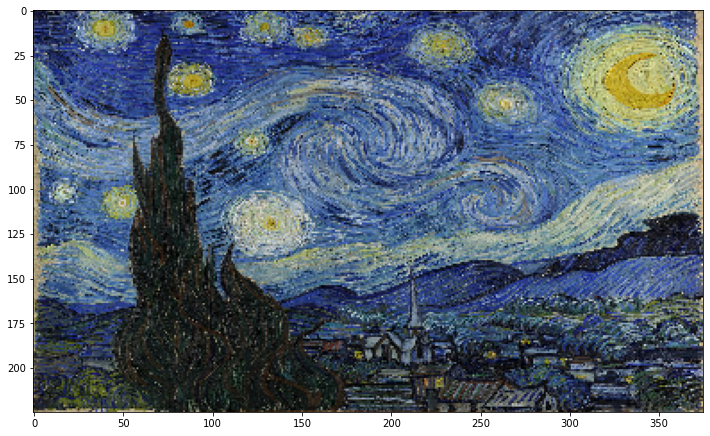

Epoch 0, loss 0.6168045401573181


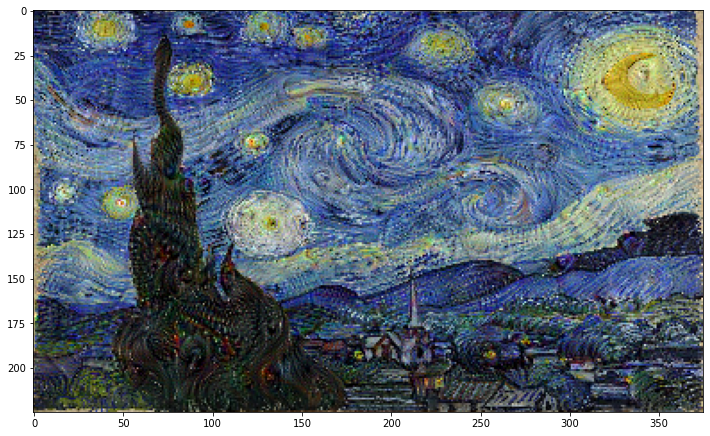

Epoch 200, loss 1.7210969924926758


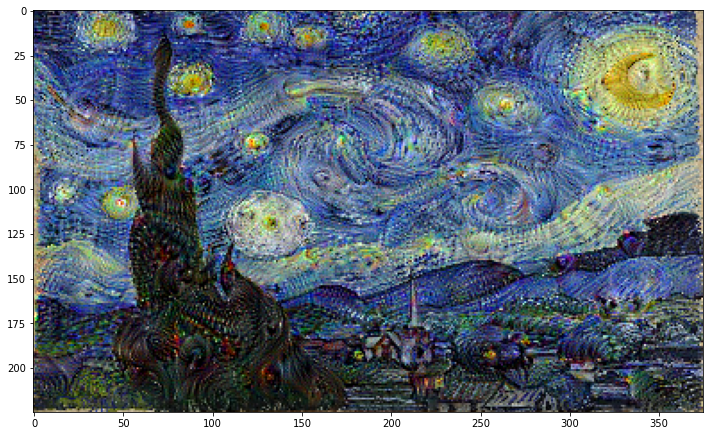

Epoch 400, loss 2.050365924835205


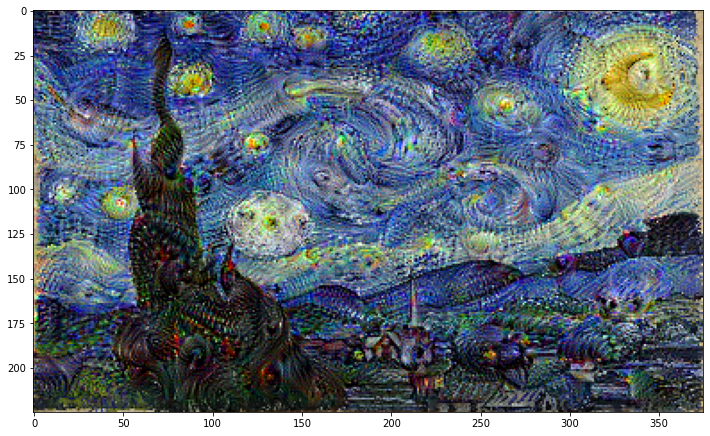

Epoch 600, loss 2.2556064128875732


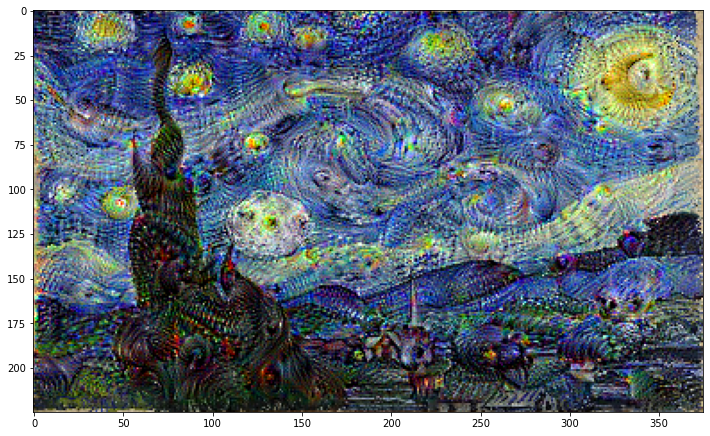

Epoch 800, loss 2.4074127674102783


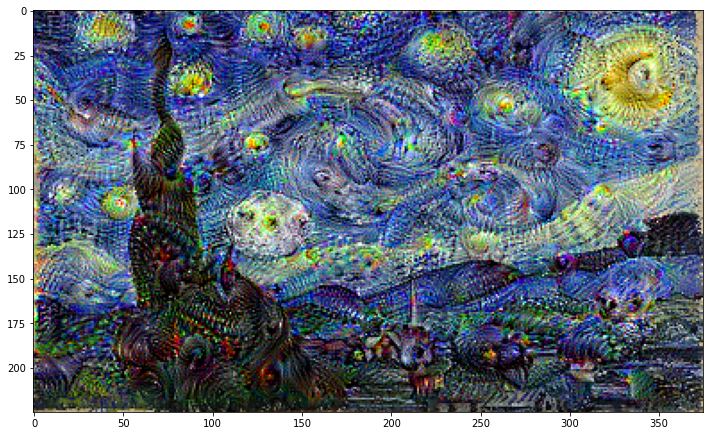

Epoch 1000, loss 2.5353705883026123


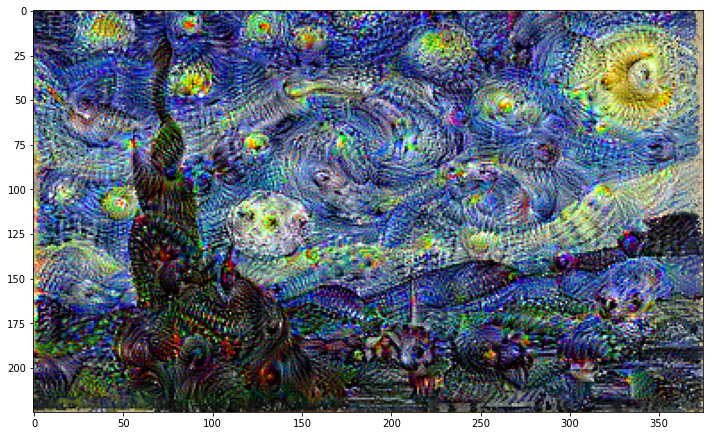

Epoch 1200, loss 2.645568370819092


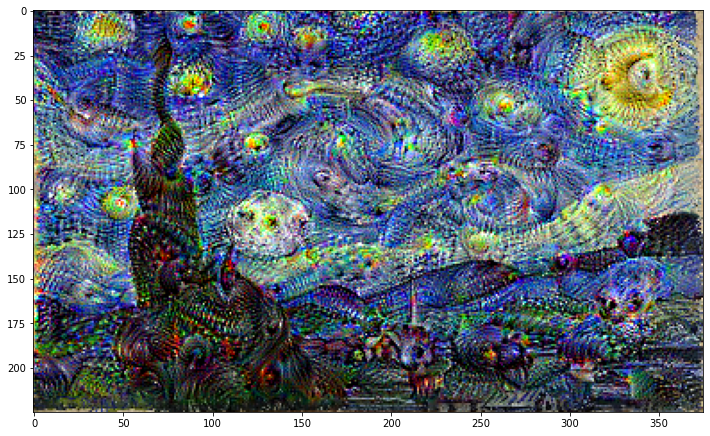

Epoch 1400, loss 2.74514102935791


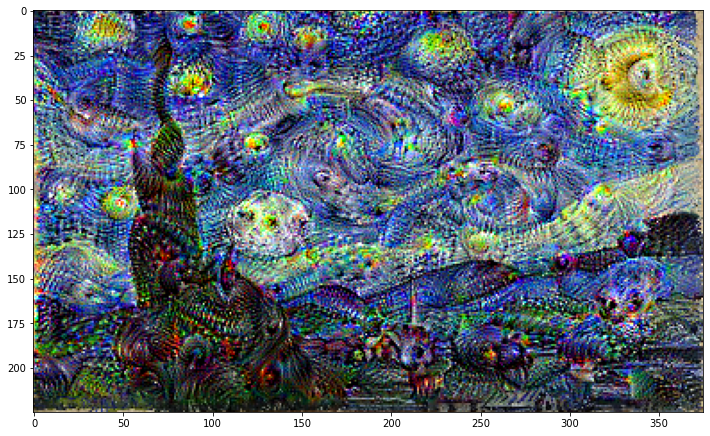

Epoch 1600, loss 2.8352625370025635


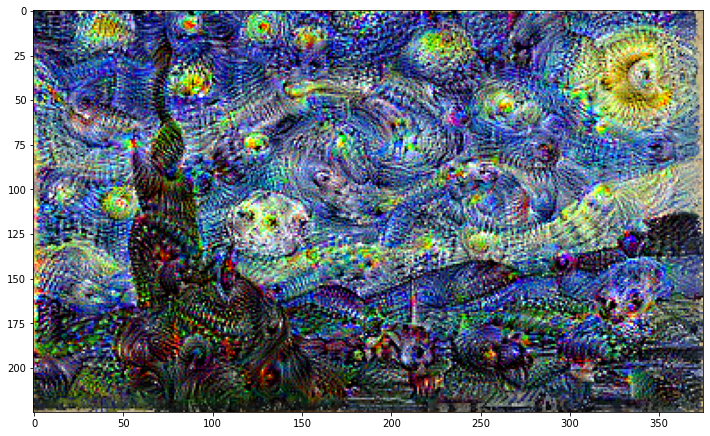

Epoch 1800, loss 2.91788387298584


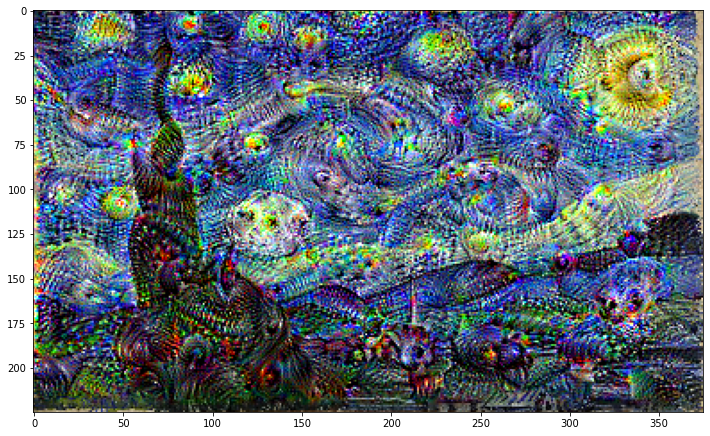

Epoch 2000, loss 2.9946401119232178


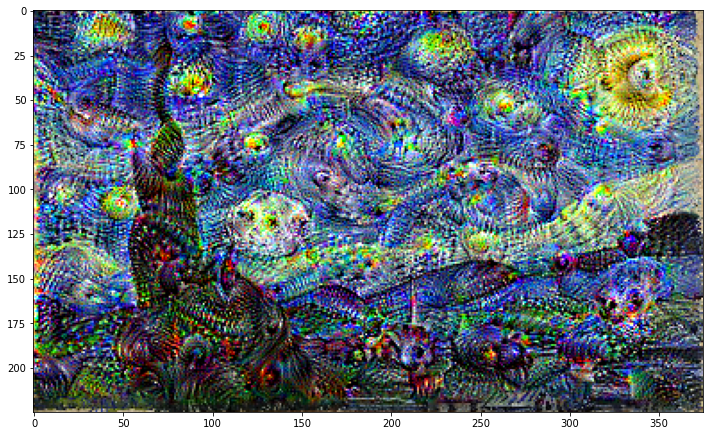

Epoch 2200, loss 3.0663740634918213


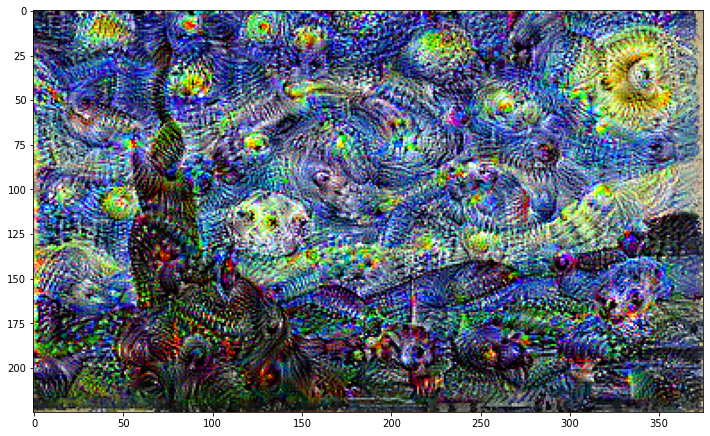

Epoch 2400, loss 3.1317954063415527


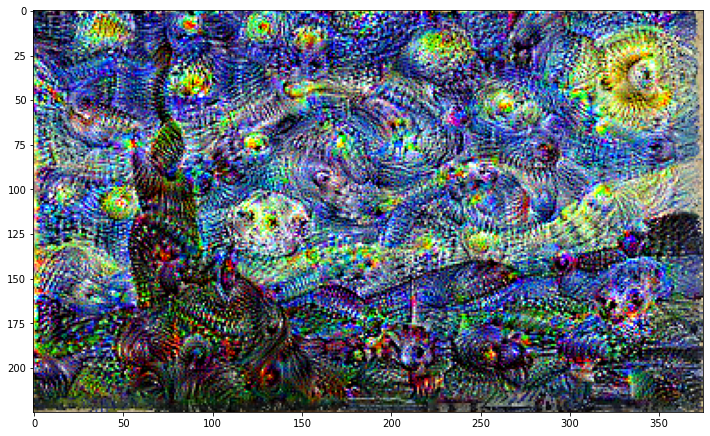

Epoch 2600, loss 3.1941733360290527


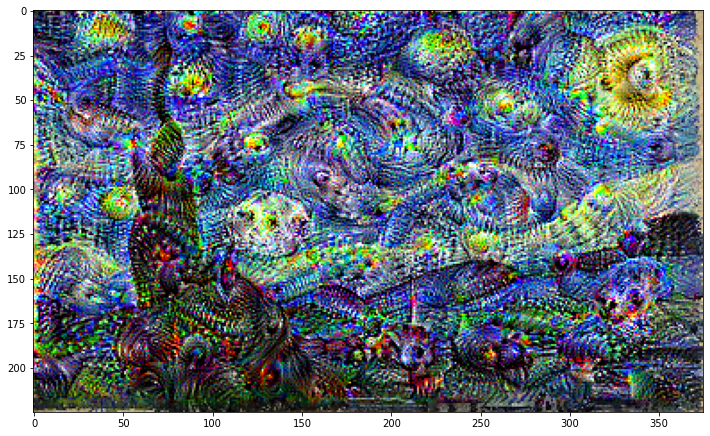

Epoch 2800, loss 3.2522640228271484


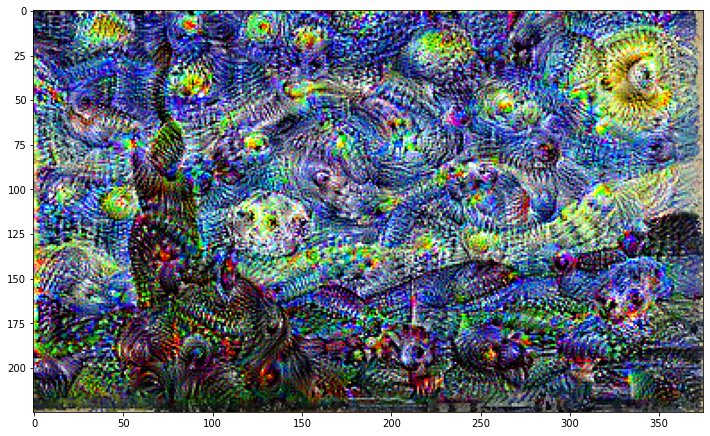

Epoch 3000, loss 3.3046343326568604


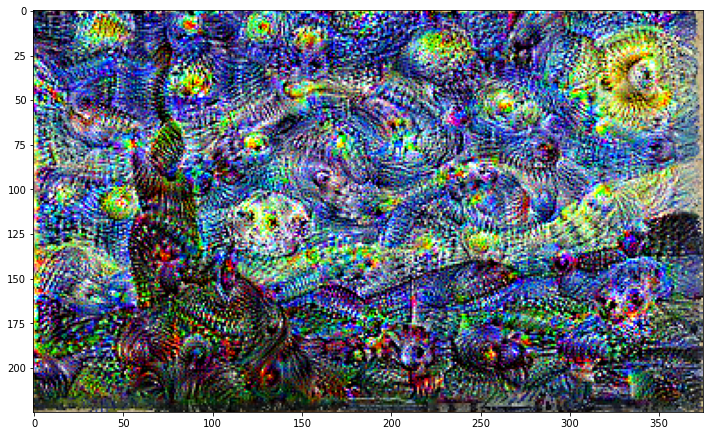

Epoch 3200, loss 3.3527073860168457


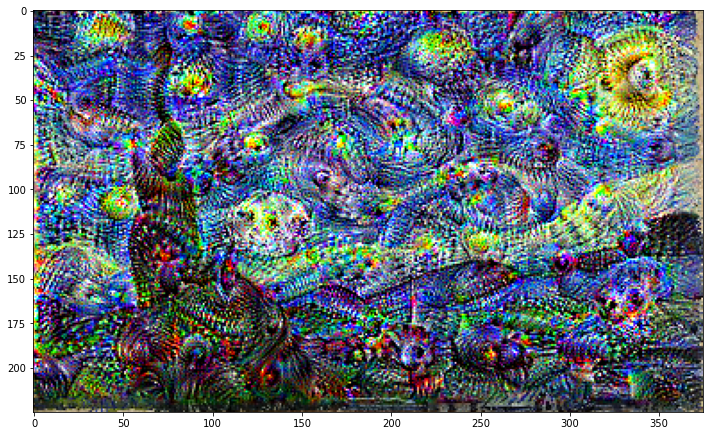

Epoch 3400, loss 3.3983590602874756


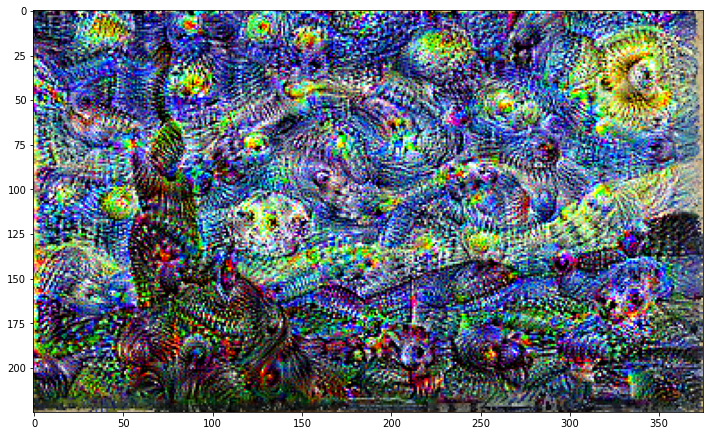

Epoch 3600, loss 3.4432778358459473


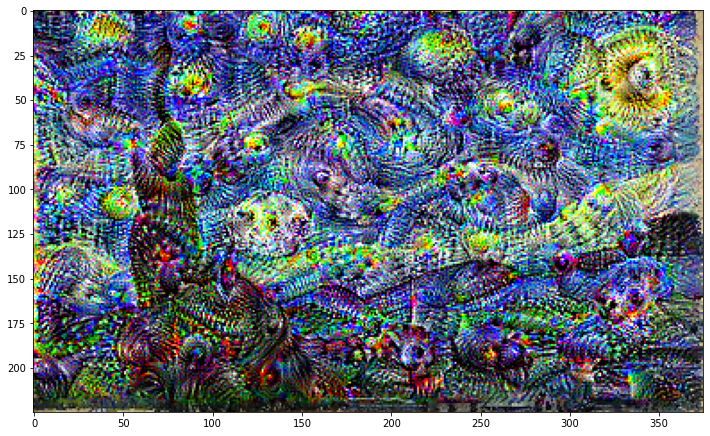

Epoch 3800, loss 3.4858462810516357


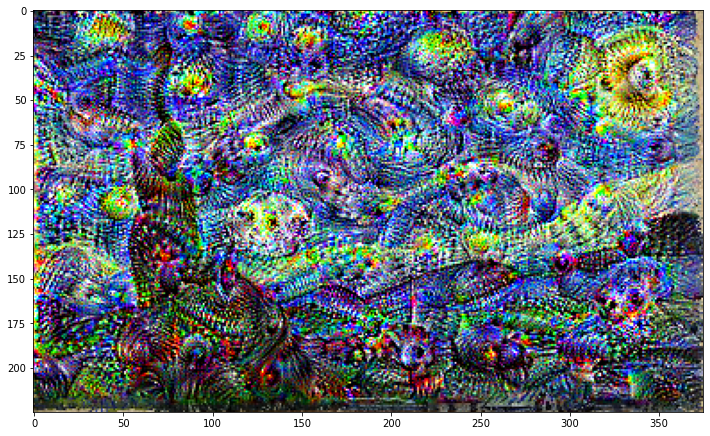

Epoch 4000, loss 3.5255589485168457


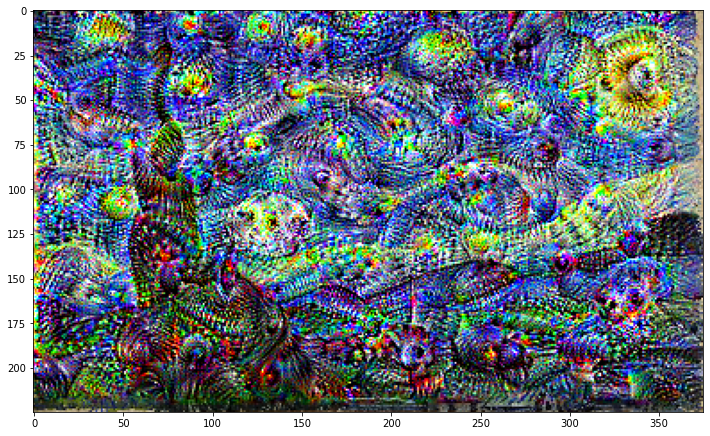

Epoch 4200, loss 3.563411235809326


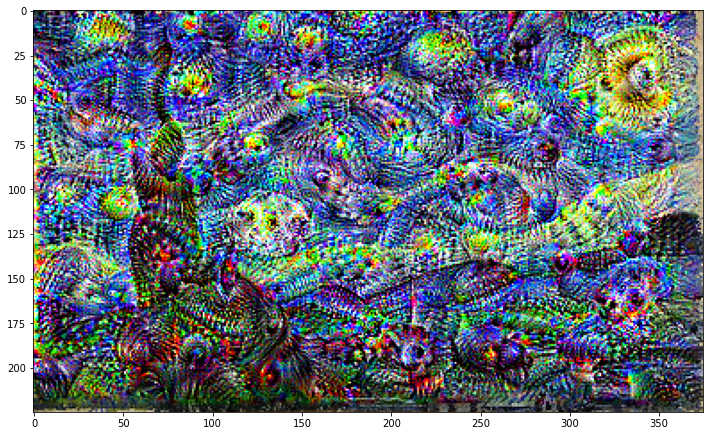

Epoch 4400, loss 3.5991477966308594


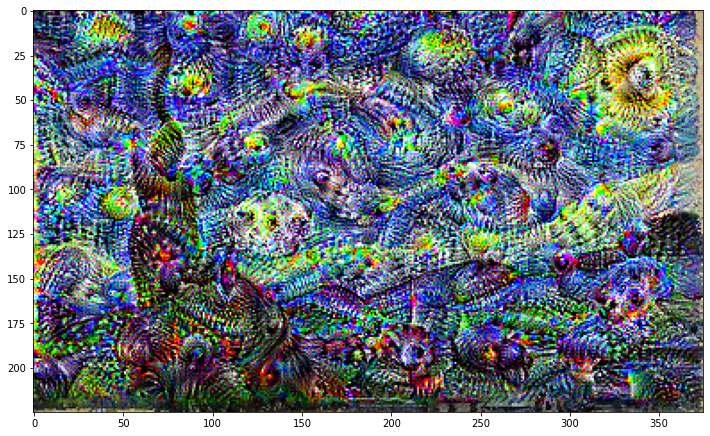

Epoch 4600, loss 3.6332459449768066


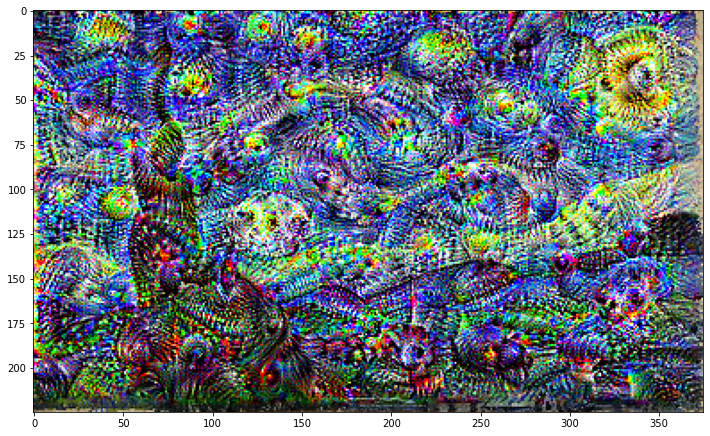

Epoch 4800, loss 3.665771007537842


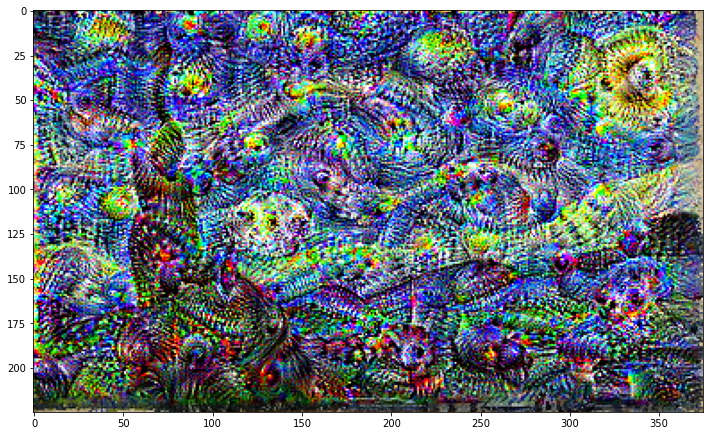

Epoch 5000, loss 3.6967344284057617


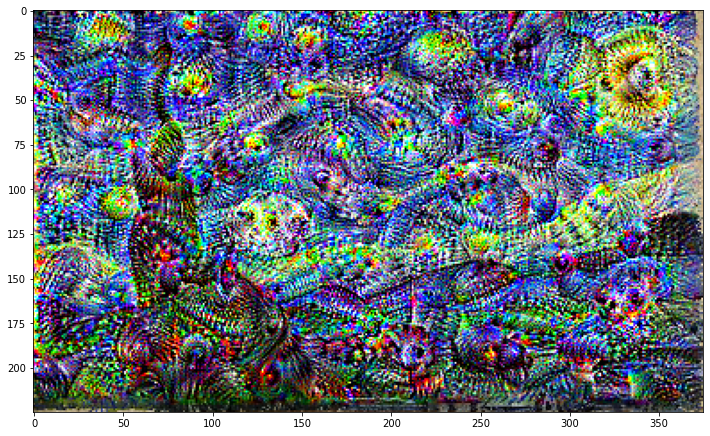

Epoch 5200, loss 3.7265138626098633


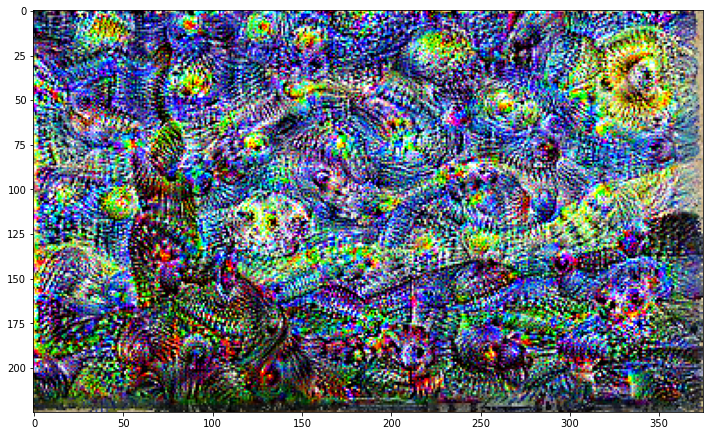

Epoch 5400, loss 3.754322052001953


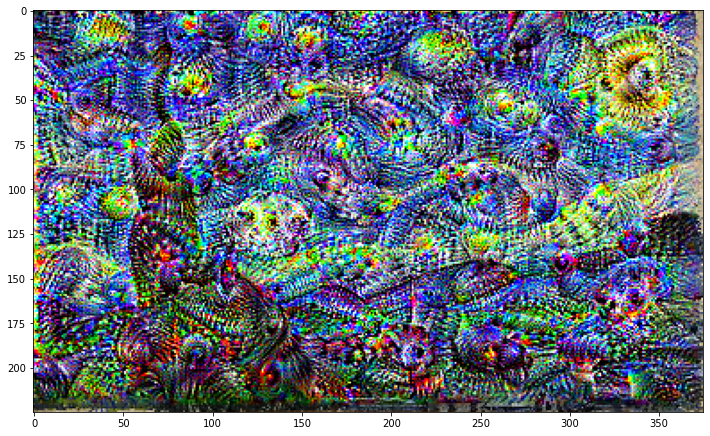

Epoch 5600, loss 3.7811717987060547


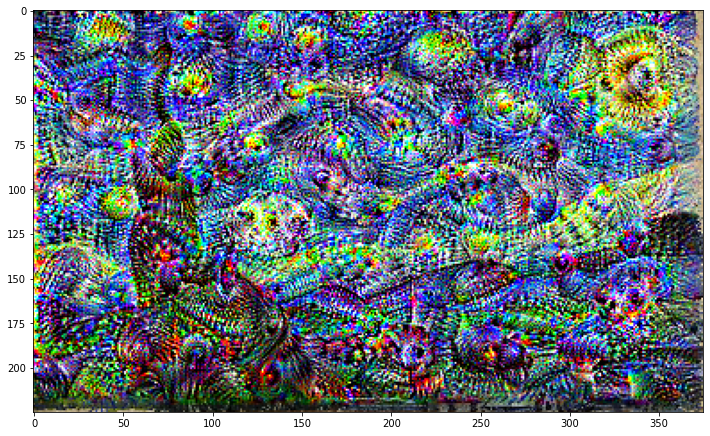

Epoch 5800, loss 3.8075642585754395


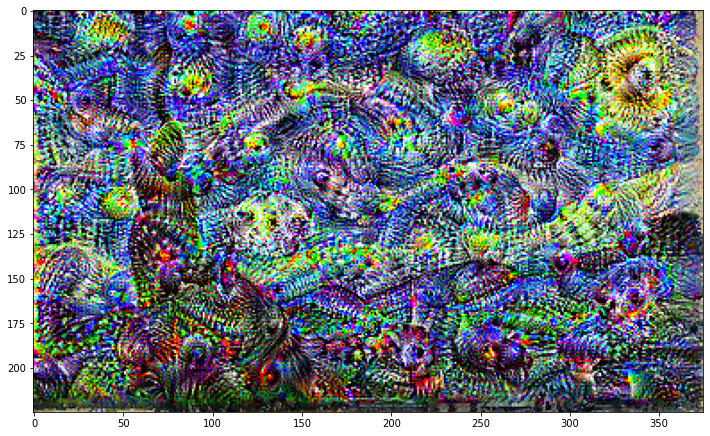

Epoch 6000, loss 3.832986831665039


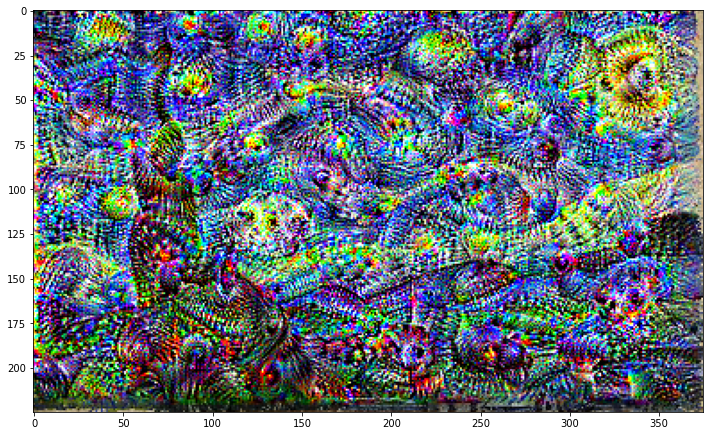

Epoch 6200, loss 3.857090711593628


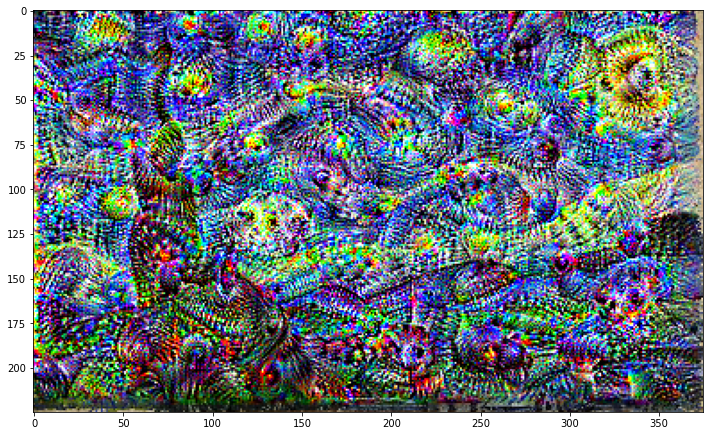

Epoch 6400, loss 3.880042552947998


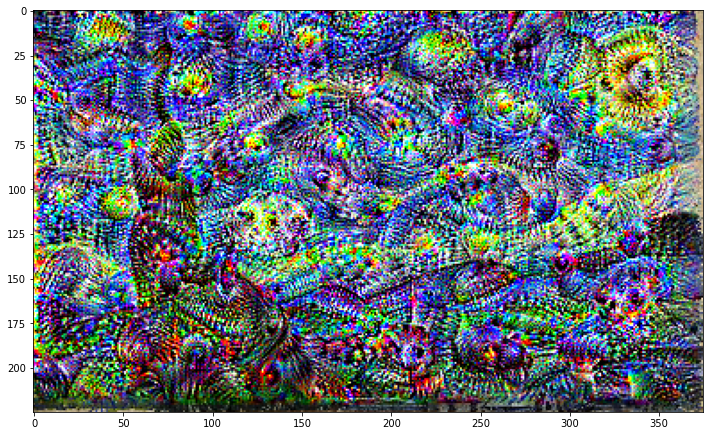

Epoch 6600, loss 3.902574062347412


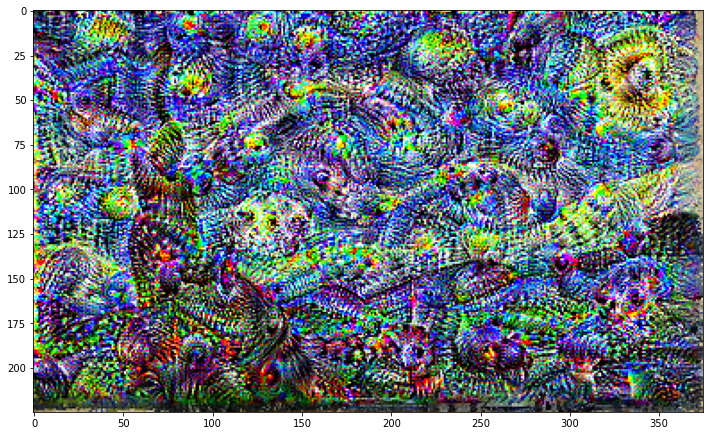

Epoch 6800, loss 3.92488956451416


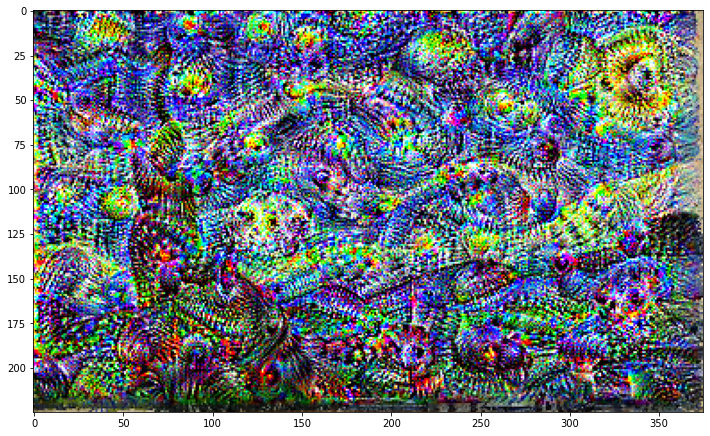

Epoch 7000, loss 3.9468765258789062


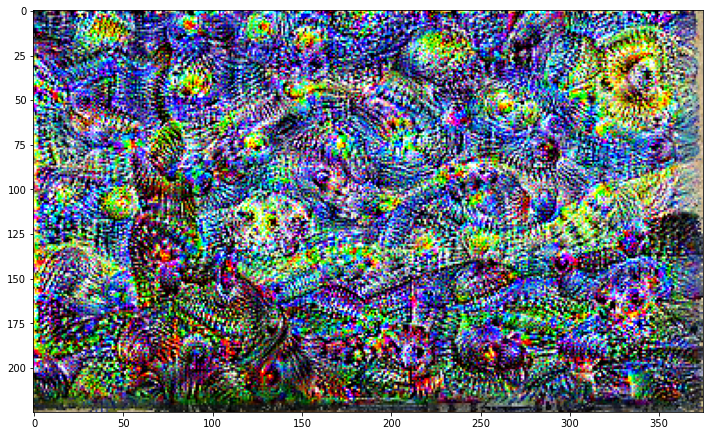

Epoch 7200, loss 3.96826171875


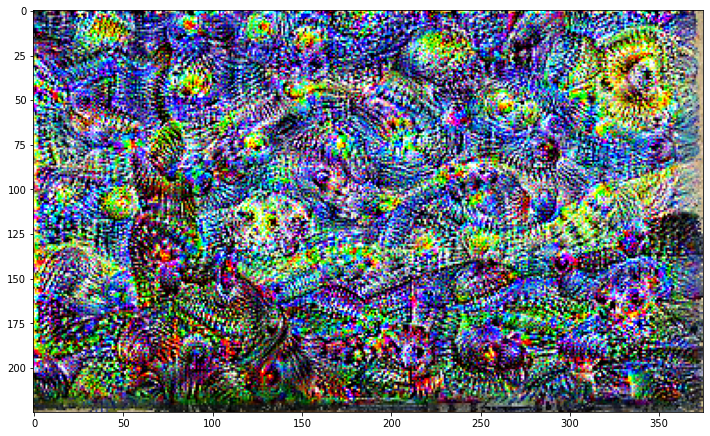

Epoch 7400, loss 3.9881582260131836


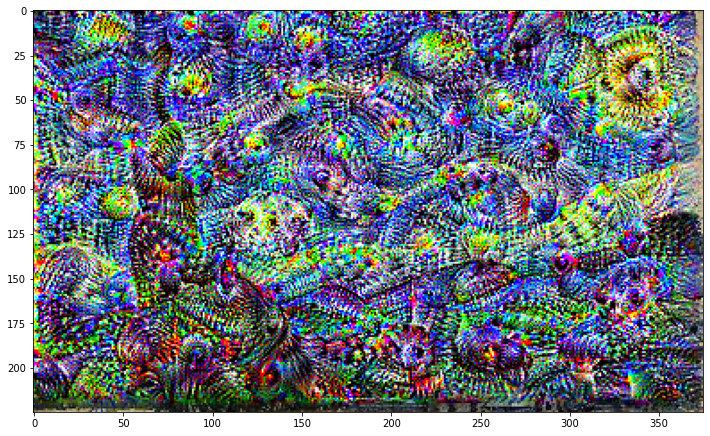

Epoch 7600, loss 4.007999897003174


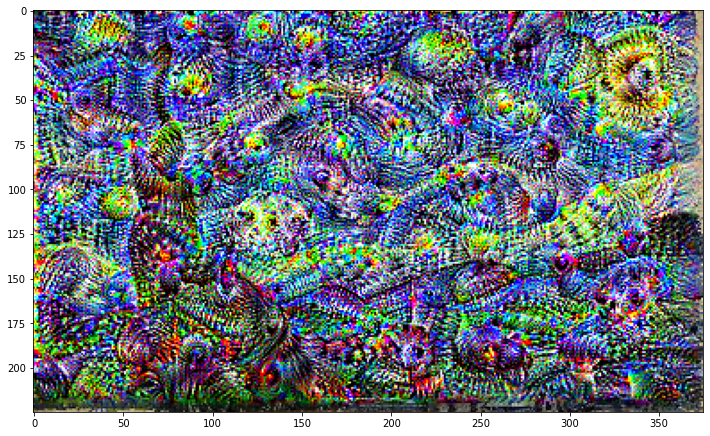

Epoch 7800, loss 4.027563571929932


In [ ]:
run_deep_dream(network = deep_dream_model,image =image,epochs=8000,learning_rate=0.001)